In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import folium

In [3]:
df = pd.read_csv('/content/drive/MyDrive/GitHub/loan_themes_by_region.csv')

Here, we are working on the loan_themes_by_region dataset. the dataset is loaded and contained in df variable.

In [4]:
df.head()

,Partner ID,Field Partner Name,sector,Loan Theme ID,Loan Theme Type,country,forkiva,region,geocode_old,ISO,...,amount,LocationName,geocode,names,geo,lat,lon,mpi_region,mpi_geo,rural_pct
0,9,KREDIT Microfinance Institution,General Financial Inclusion,a1050000000slfi,Higher Education,Cambodia,No,Banteay Meanchey,"(13.75, 103.0)",KHM,...,450,"Banteay Meanchey, Cambodia","[(13.6672596, 102.8975098)]",Banteay Meanchey Province; Cambodia,"(13.6672596, 102.8975098)",13.667260,102.897510,"Banteay Mean Chey, Cambodia","(13.6672596, 102.8975098)",90.0
1,9,KREDIT Microfinance Institution,General Financial Inclusion,a10500000068jPe,Vulnerable Populations,Cambodia,No,Battambang Province,NaN,KHM,...,20275,"Battambang Province, Cambodia","[(13.0286971, 102.989615)]",Battambang Province; Cambodia,"(13.0286971, 102.989615)",13.028697,102.989615,"Banteay Mean Chey, Cambodia","(13.6672596, 102.8975098)",90.0
2,9,KREDIT Microfinance Institution,General Financial Inclusion,a1050000000slfi,Higher Education,Cambodia,No,Battambang Province,NaN,KHM,...,9150,"Battambang Province, Cambodia","[(13.0286971, 102.989615)]",Battambang Province; Cambodia,"(13.0286971, 102.989615)",13.028697,102.989615,"Banteay Mean Chey, Cambodia","(13.6672596, 102.8975098)",90.0
3,9,KREDIT Microfinance Institution,General Financial Inclusion,a10500000068jPe,Vulnerable Populations,Cambodia,No,Kampong Cham Province,"(12.0, 105.5)",KHM,...,604950,"Kampong Cham Province, Cambodia","[(12.0982918, 105.3131185)]",Kampong Cham Province; Cambodia,"(12.0982918, 105.3131185)",12.098292,105.313119,"Kampong Cham, Cambodia","(11.9924294, 105.4645408)",90.0
4,9,KREDIT Microfinance Institution,General Financial Inclusion,a1050000002X1Uu,Sanitation,Cambodia,No,Kampong Cham Province,"(12.0, 105.5)",KHM,...,275,"Kampong Cham Province, Cambodia","[(12.0982918, 105.3131185)]",Kampong Cham Province; Cambodia,"(12.0982918, 105.3131185)",12.098292,105.313119,"Kampong Cham, Cambodia","(11.9924294, 105.4645408)",90.0


In [5]:
df.shape

(15736, 21)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15736 entries, 0 to 15735
Data columns (total 21 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Partner ID          15736 non-null  int64  
 1   Field Partner Name  15736 non-null  object 
 2   sector              15736 non-null  object 
 3   Loan Theme ID       15736 non-null  object 
 4   Loan Theme Type     15736 non-null  object 
 5   country             15736 non-null  object 
 6   forkiva             15736 non-null  object 
 7   region              15736 non-null  object 
 8   geocode_old         1200 non-null   object 
 9   ISO                 15722 non-null  object 
 10  number              15736 non-null  int64  
 11  amount              15736 non-null  int64  
 12  LocationName        15736 non-null  object 
 13  geocode             13662 non-null  object 
 14  names               13661 non-null  object 
 15  geo                 15736 non-null  object 
 16  lat 

The information shows that the dataset has many missing values that has to be handled and features has to be assigned in correct data types before proceeding to exploratory data analysis.

In [7]:
df.isnull().sum()

,0
Partner ID,0
Field Partner Name,0
sector,0
Loan Theme ID,0
Loan Theme Type,0
country,0
forkiva,0
region,0
geocode_old,14536
ISO,14


the `isnull().sum()` function shows how many missing values are present in which features. here we can see that `geocode_old`,`ISO`, `geocode`, `names`, `lat`, `lon`, `mpi_region`, `mpi_geo`, `rural_pct` `Inline code` has missing values. we will handle the missing values according to their proportion and importance for the analysis.






In [8]:
df.drop(columns=['geocode_old', 'mpi_geo'], inplace=True)

`geocode_old`, `mpi_geo`, has high proportion of missing values. therefore removing these columns is the best course of action rather than imputing them with statistical and imputational method.

In [9]:
df['ISO'].fillna('Unknown', inplace=True)
df['mpi_region'].fillna('Unknown', inplace=True)
df['rural_pct'].fillna(df['rural_pct'].median(), inplace=True)
df['geocode'].fillna('Unknown', inplace=True)
df['names'].fillna('Unknown', inplace=True)

df.dropna(subset=['lat', 'lon'], inplace=True)

The missing values in categorical features are replaced with "Unknown", as they are low in number and can be categorized in a new category. Furthermore, the missing values of geographical values are treated with removing the rows containing missing values of such features.

In [10]:
df['amount'] = df['amount'].astype(float)
df['rural_pct'] = df['rural_pct'].astype(float)
categorical_columns = ['Field Partner Name', 'sector', 'Loan Theme ID', 'Loan Theme Type', 'forkiva', 'region', 'ISO', 'LocationName', 'geo', 'mpi_region']
df[categorical_columns] = df[categorical_columns].astype('category')

Here, the features are converted into the appropriate data types based on their values.

In [13]:
df.isnull().sum()

,0
Partner ID,0
Field Partner Name,0
sector,0
Loan Theme ID,0
Loan Theme Type,0
country,0
forkiva,0
region,0
ISO,0
number,0


Now, we can see that there are no more missing values in the dataset and we can proceed to the exploratory data analysis.

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13662 entries, 0 to 15735
Data columns (total 19 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Partner ID          13662 non-null  int64   
 1   Field Partner Name  13662 non-null  category
 2   sector              13662 non-null  category
 3   Loan Theme ID       13662 non-null  category
 4   Loan Theme Type     13662 non-null  category
 5   country             13662 non-null  object  
 6   forkiva             13662 non-null  category
 7   region              13662 non-null  category
 8   ISO                 13662 non-null  category
 9   number              13662 non-null  int64   
 10  amount              13662 non-null  float64 
 11  LocationName        13662 non-null  category
 12  geocode             13662 non-null  object  
 13  names               13662 non-null  object  
 14  geo                 13662 non-null  category
 15  lat                 13662 non-null  float

In [15]:
df.describe()

,Partner ID,number,amount,lat,lon,rural_pct
count,13662.000000,13662.000000,1.366200e+04,13662.000000,13662.000000,13662.000000
mean,184.401332,59.275655,2.223745e+04,14.328878,29.433569,66.783121
std,110.018643,429.616795,1.026640e+05,16.757689,83.255739,25.699009
min,9.000000,1.000000,2.500000e+01,-34.610548,-172.790661,0.000000
25%,123.000000,1.000000,1.025000e+03,6.266728,-71.967463,60.000000
50%,151.000000,4.000000,3.000000e+03,13.484101,41.899993,73.000000
75%,204.000000,16.000000,1.010000e+04,22.189940,106.677321,84.000000
max,545.000000,22538.000000,4.929900e+06,51.314017,159.972900,100.000000


From the data description, we can see some statistical figures of amount and rural_pct.

For 'amount'
*   Mean: 22237.45
*   Median: 3000.00

For 'rural_pct'
*   Mean: 66.78
*   Median: 73





<ipython-input-16-0020ef640ea4>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, y='sector', order=df['sector'].value_counts().index, palette='viridis')


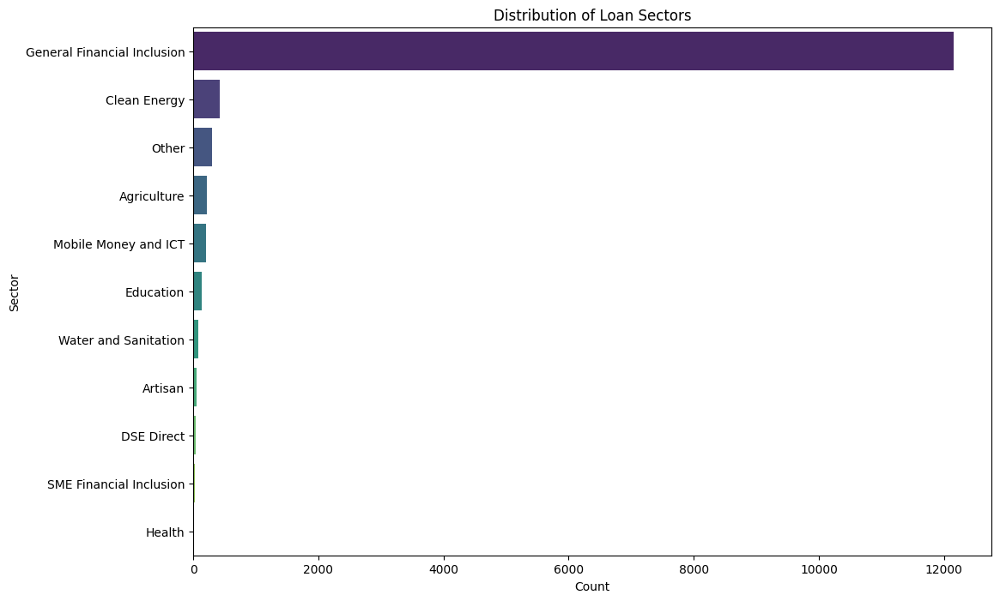

In [16]:
plt.figure(figsize=(12, 8))
sns.countplot(data=df, y='sector', order=df['sector'].value_counts().index, palette='viridis')
plt.title('Distribution of Loan Sectors')
plt.xlabel('Count')
plt.ylabel('Sector')
plt.show()


From the countplot above, we can see that loans are disbursed for General Financial Inclusion are significantly larger than any other loan sectors.

<ipython-input-17-dd51bd29c77d>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, y='Loan Theme Type', order=df['Loan Theme Type'].value_counts().index[:10], palette='viridis')


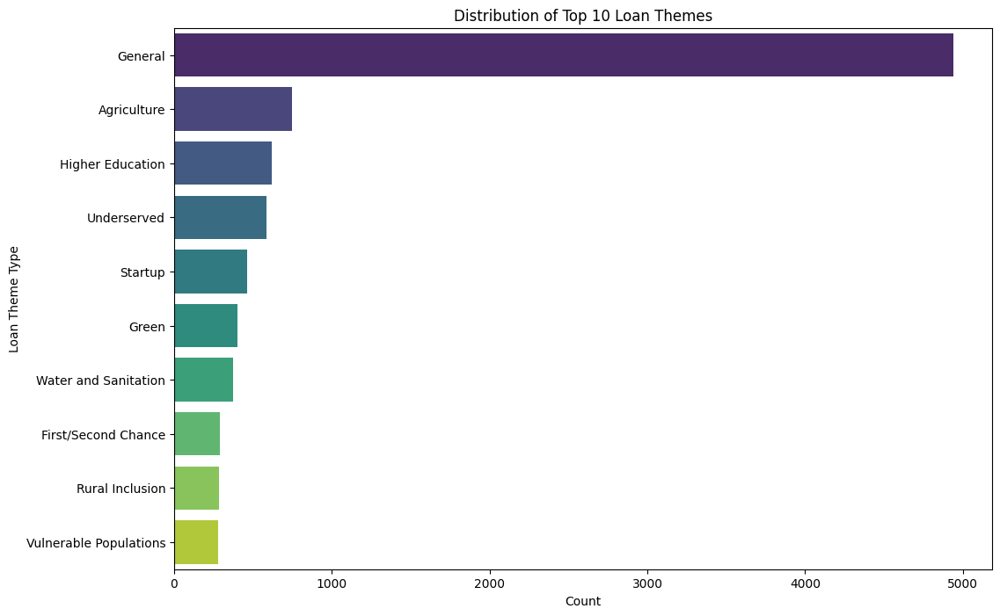

In [17]:
plt.figure(figsize=(12, 8))
sns.countplot(data=df, y='Loan Theme Type', order=df['Loan Theme Type'].value_counts().index[:10], palette='viridis')
plt.title('Top 10 Loan Themes')
plt.xlabel('Count')
plt.ylabel('Loan Theme Type')
plt.show()


Subsequently, loan theme of general category is very popular among the other categories. After general themed loan, there are agriculture, higher education, underserved and startup loan themes that are availed by the borrowers.

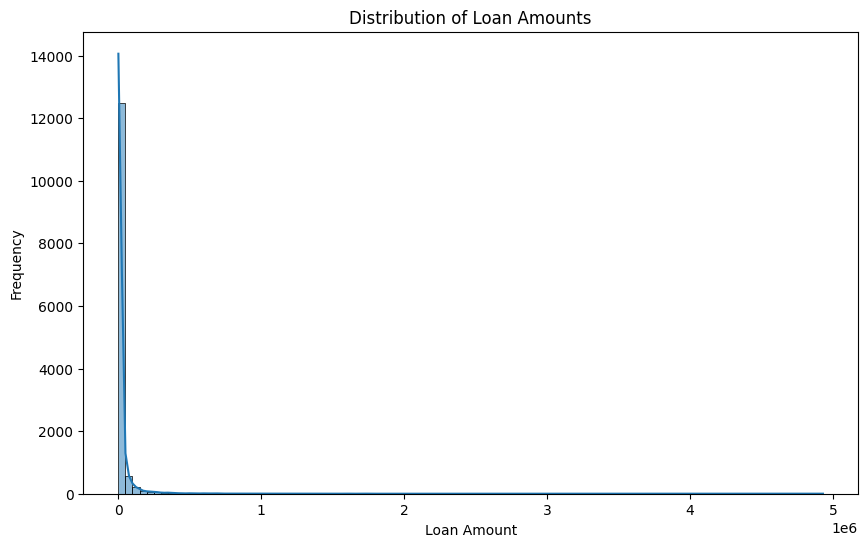

In [19]:
plt.figure(figsize=(10, 6))
sns.histplot(df['amount'], bins=100, kde=True)
plt.title('Distribution of Loan Amounts')
plt.xlabel('Loan Amount')
plt.ylabel('Frequency')
plt.show()


The loan amount is highly skewed, indicating that number of low amounted loans are more than high amounted loans.

<ipython-input-22-282010b90228>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, y='Field Partner Name', order=df['Field Partner Name'].value_counts().index[:10], palette='viridis')


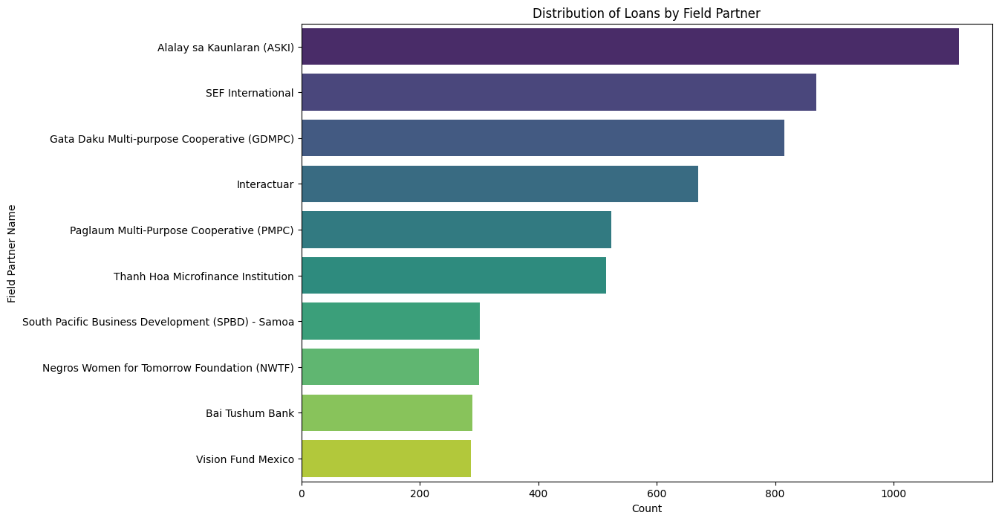

In [22]:
plt.figure(figsize=(12, 8))
sns.countplot(data=df, y='Field Partner Name', order=df['Field Partner Name'].value_counts().index[:10], palette='viridis')
plt.title('Top 10 Loan Field Partner')
plt.xlabel('Count')
plt.ylabel('Field Partner Name')
plt.show()


Many field partners are present to reach out to the unbanked people to provide them lending facilities. ASKI, SEF International and GDMPC are the top three parnters that have reached to most people.

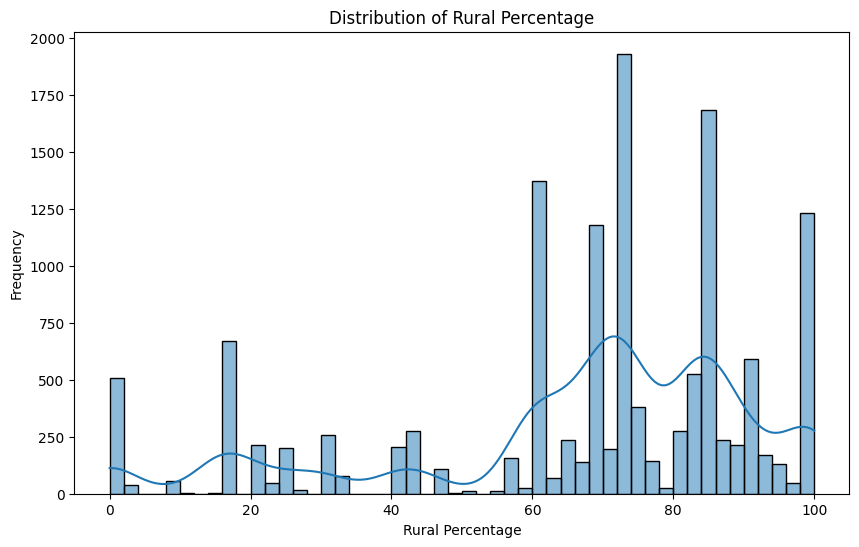

In [20]:
plt.figure(figsize=(10, 6))
sns.histplot(df['rural_pct'], bins=50, kde=True)
plt.title('Distribution of Rural Percentage')
plt.xlabel('Rural Percentage')
plt.ylabel('Frequency')
plt.show()


The plot is showing that these loans are focused for people living in rural area. as the rural percentage increases the frequency of number of loans also increase.

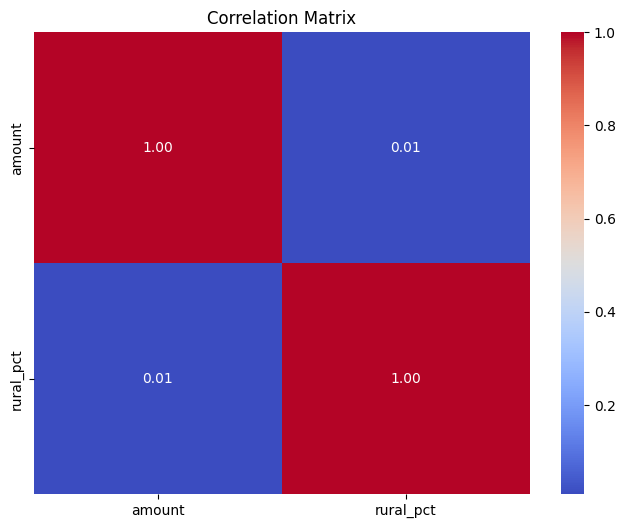

In [21]:
correlation_matrix = df[['amount', 'rural_pct']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()


However, there are no significant correlation between loan amount and rural pct score.

In [24]:
world_map = folium.Map(location=[0, 0], zoom_start=2)

# Adding city markers to the map
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lon']],
        radius=5,
        # Defining popup labels
        popup=f"{row['Field Partner Name']}, {row['sector']} {row['country']}",
        color="blue",
        fill=True,
        fill_color="blue"
    ).add_to(world_map)

world_map

The tickers in the map shows the loans are spreaded in multiple countries acrros many continents.

<ipython-input-23-872a88a8971f>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='amount', data=top_15_countries_df, palette='viridis')


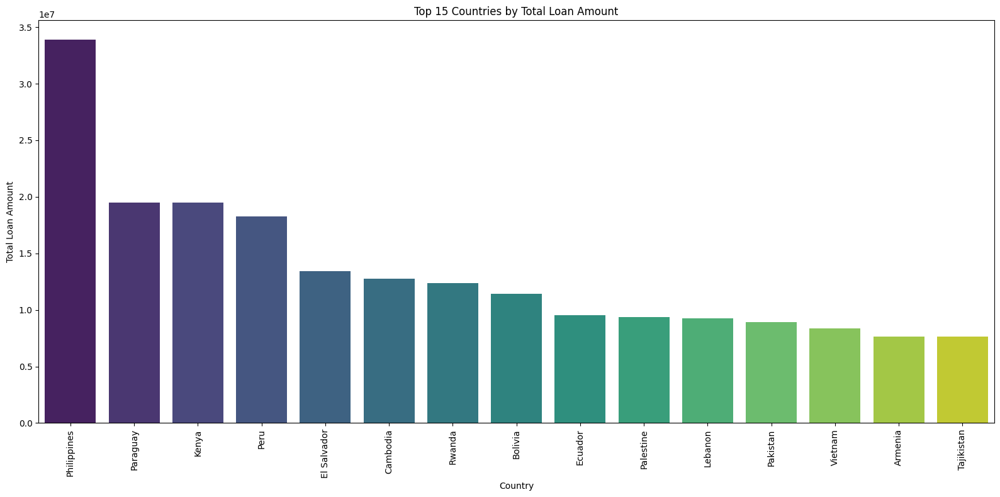

In [23]:
country_loan_amounts = df.groupby('country')['amount'].sum()

top_15_countries = country_loan_amounts.sort_values(ascending=False).head(15)

top_15_countries_df = top_15_countries.to_frame().reset_index()

plt.figure(figsize=(16, 8))
sns.barplot(x='country', y='amount', data=top_15_countries_df, palette='viridis')
plt.title('Top 15 Countries by Total Loan Amount')
plt.xlabel('Country')
plt.ylabel('Total Loan Amount')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


This gives a clearer picture of the countires where most loans have been taken. People of phillippines have taken tha highest loans and paraguay, kenya and peru comes in after that.